# Customer Segmentation
### Segmentation by RFM clustering
Why?

Because you can’t treat every customer the same way with the same content, same channel, same importance. They will find another option which understands them better.

You can do many different segmentations according to what you are trying to achieve. If you want to increase retention rate, you can do a segmentation based on churn probability and take actions. 

<div class="alert alert-info">
<i>
Churn rate, in its broadest sense, is a measure of the number of individuals or items moving out of a collective group over a specific period. It is one of two primary factors that determine the steady-state level of customers a business will support.</i>
    - Wikipedia
</div>

But there are very common and useful segmentation methods as well. Now we are going to implement one of them to our business: **RFM**.

<p id="freq" style="background:red; color:white"></p>
<a href="#freq"></a>
<div class="alert alert-success">
RFM stands for Recency - Frequency - Monetary Value. Theoretically we will have segments like below:
<br>
    
 - <strong>Low Value</strong>: Customers who are less active than others, not very frequent buyer/visitor and generates very low - zero - maybe negative revenue.<br>  
 - <strong>Mid Value</strong>: In the middle of everything. Often using our platform (but not as much as our High Values), fairly frequent and generates moderate revenue.<br>
 - <strong>High Value</strong>: The group we don’t want to lose. High Revenue, Frequency and low Inactivity.


## RFM Clustering

As the methodology, we need to calculate Recency, Frequency and Monetary Value (we will call it Revenue from now on) and apply unsupervised machine learning to identify different groups (clusters) for each. Let’s jump into coding and see how to do RFM Clustering.

1. <a href="#rec">Calculating Recency</a>
<ol>
    <li><a href="#recq">Quantiles</a></li>
    <li><a href="#reck">KMeans</a></li>
    <li><a href="#recg">Gaussian Mixture</a></li>
</ol>
2. <a href="#freq">Calculating Frequency</a>
<ol>
    <li><a href="#freqq">Quantiles</a></li>
    <li><a href="#freqk">KMeans</a></li>
    <li><a href="#freqg">Gaussian Mixture</a></li>
</ol>
3. <a href="#mon">Calculating Monetary</a>
<ol>
    <li><a href="#monq">Quantiles</a></li>
    <li><a href="#monk">KMeans</a></li>
    <li><a href="#mong">Gaussian Mixture</a></li>
</ol>

And Finally
- <a href="#over">Overall Score</a>

In [1]:
%config Completer.use_jedi = False

# import libraries
from datetime import datetime, timedelta
import pandas as pd
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from __future__ import division

import chart_studio.plotly as py
import plotly.offline as pyoff
import plotly.graph_objs as go

import warnings

#inititate Plotly
pyoff.init_notebook_mode()

# import warnings
warnings.filterwarnings("ignore")

In [2]:
#function for ordering cluster numbers
def order_cluster(cluster_field_name, target_field_name, df, ascending):
    
    new_cluster_field_name = 'new_' + cluster_field_name
    df_new = df.groupby(cluster_field_name)[target_field_name].mean().reset_index()
    df_new = df_new.sort_values(by=target_field_name,ascending=ascending).reset_index(drop=True)
    df_new['index'] = df_new.index
    df_final = pd.merge(df,df_new[[cluster_field_name,'index']], on=cluster_field_name)
    df_final = df_final.drop([cluster_field_name],axis=1)
    df_final = df_final.rename(columns={"index":cluster_field_name})
    return df_final

In [3]:
columns = ["status", "amount", "id", "user_id", "province", "city", "address",
           "coupon_code", "coupon_discount", "created_at", "credit_amount", "nickname", "paid_at", "mobile"]

In [9]:
# pi = pd.read_csv("pi_201909.csv", usecols=columns, low_memory=False)
pi = pd.read_csv("pi_2020-04-01_2021-02-01.csv")

In [10]:
pi.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 782898 entries, 0 to 782897
Data columns (total 9 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   Unnamed: 0     782898 non-null  int64 
 1   Unnamed: 0.1   782898 non-null  int64 
 2   amount         782898 non-null  int64 
 3   credit_amount  782898 non-null  int64 
 4   paid_at        782898 non-null  object
 5   id             782898 non-null  int64 
 6   user_id        782898 non-null  int64 
 7   city           782898 non-null  int64 
 8   mobile         781495 non-null  object
dtypes: int64(7), object(2)
memory usage: 53.8+ MB


In [11]:
pi.head()

,Unnamed: 0,Unnamed: 0.1,amount,credit_amount,paid_at,id,user_id,city,mobile
0,0,0,775000,0,2020-04-01T00:01:15,667594,489707,2052,09361781349
1,1,1,465000,0,2020-04-01T00:01:25,655873,12982,2052,09125951404
2,2,2,580000,0,2020-04-01T00:02:09,667448,197411,2531,09220493191
3,3,3,614317,1445683,2020-04-01T00:02:47,660556,39977,2911,09383668915
4,4,4,18800000,0,2020-04-01T00:03:55,663912,64029,2052,09147876474


In [12]:
# the first two columns are useless they're just row numbers, two duplicates of our index
pi = pi.iloc[:, 2:]

In [13]:
pi.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 782898 entries, 0 to 782897
Data columns (total 7 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   amount         782898 non-null  int64 
 1   credit_amount  782898 non-null  int64 
 2   paid_at        782898 non-null  object
 3   id             782898 non-null  int64 
 4   user_id        782898 non-null  int64 
 5   city           782898 non-null  int64 
 6   mobile         781495 non-null  object
dtypes: int64(5), object(2)
memory usage: 41.8+ MB


In [14]:
#convert the string date field to datetime
pi['paid_at'] = pd.to_datetime(pi['paid_at'])
# pi['created_at'] = pd.to_datetime(pi["created_at"])

<div class="alert alert-warning">

Let's exclude Jan31 (The 11/11 event)
</div>

In [15]:
datetime.now()

datetime.datetime(2021, 7, 24, 22, 13, 23, 862256)

In [8]:
pi = pi.query("paid_at < datetime.datetime(2021, 1, 29, 0, 0, 0, 0)")
# pi = pi.query("created_at < datetime.datetime(2021, 1, 29, 0, 0, 0, 0)")

### Transforming Monetary unit from Rial to Toman

In [16]:
pi["Revenue"] = (pi.amount + pi.credit_amount)/10
pi.amount /= 10
pi.credit_amount /= 10

In [17]:
pi = pi.query("paid_at > datetime.datetime(2020, 4, 1, 0, 0, 0, 0)")
pi = pi.query("paid_at < datetime.datetime(2021, 1, 1, 0, 0, 0, 0)")

<p id="rec">
    
## Calculating *Recency*:
    
To calculate recency, we need to find out most recent purchase date of each customer and see how many days they are inactive for. After having no. of inactive days for each customer, we will apply both **K-means**, **Gaussian Mixture** and finally **quantiles**(offered by Mr. Sadeghi) clustering to assign customers a recency score.

In [18]:
#create a generic user dataframe to keep CustomerID and new segmentation scores
pi_user = pd.DataFrame(pi['user_id'].unique())
pi_user.columns = ['user_id']

#get the max purchase date for each customer and create a dataframe with it
pi_max_purchase = pi.groupby('user_id').paid_at.max().reset_index()
pi_max_purchase.columns = ['user_id','MaxPurchaseDate']

#we take our observation point as the max invoice date in our dataset
pi_max_purchase['Recency'] = (pi_max_purchase['MaxPurchaseDate'].max() - pi_max_purchase['MaxPurchaseDate']).dt.days

#merge this dataframe to our new user dataframe
pi_user = pd.merge(pi_user, pi_max_purchase[['user_id','Recency']], on='user_id')

pi_user.head(5)

,user_id,Recency
0,489707,274
1,12982,18
2,197411,23
3,39977,1
4,64029,3


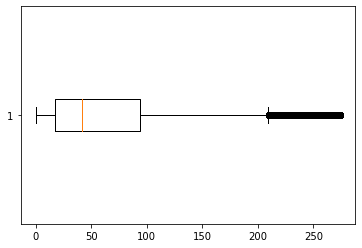

In [19]:
plt.boxplot(pi_user.Recency, vert=False);

In [20]:
#plot a recency histogram
#x=pi_user[pi_user['Recency'] != np.inf]["Recency"]

plot_data = [
    go.Histogram(
        x=pi_user.Recency,
        marker=dict(
            color='rgba(110, 190, 0, .7)',
        ),
    )
]

plot_layout = go.Layout(
        title='Recency',
        plot_bgcolor = "rgba(30, 50, 40, .3)",
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

<div class="alert alert-danger">
The distribution is strongly skewed, so we need to apply some kind of transformation to this, maybe normalize it!
    
[See this](https://towardsdatascience.com/the-most-important-data-science-tool-for-market-and-customer-segmentation-c9709ca0b64a). The further thing is that logarithmic scale won't do any good when you visualize your data :-(

In [33]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
xpu = sc.fit_transform(np.log((pi_user["Recency"]**(13/17)).values.reshape(-1,1) + 1))

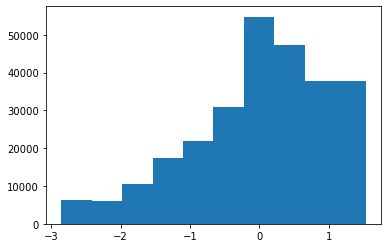

In [34]:
plt.hist((xpu));

Recall the transformation:
$$T(x) = \log_{10}{(x^\frac{13}{17} + 1)}$$

That's better! Though still some inconsistency at the end tail.

In [36]:
pi_user["Recency_Transformed"] = sc.fit_transform((pi_user.Recency**(13/17)).values.reshape(-1,1))

# These are for Quantiles and Gaussian respectively
pi_user_q, pi_user_g = pi_user.copy(), pi_user.copy()

Now it is the fun part. We are going to apply **K-means clustering** to assign a recency score. But we should tell how many clusters we need to **K-means** algorithm. To find it out, we will apply **Elbow** Method. Elbow Method simply tells the optimal cluster number for optimal inertia.

In [37]:
pi_user.head(10)

,user_id,Recency,Recency_Transformed
0,489707,274,2.627322
1,12982,18,-0.735272
2,197411,23,-0.636537
3,39977,1,-1.161659
4,64029,3,-1.092507
5,386097,274,2.627322
6,495466,250,2.367261
7,495442,244,2.301343
8,495437,151,1.221473
9,473912,5,-1.034358


<p id="recq">

### The Method of Quantiles for Recency

In [38]:
pi_user.Recency_Transformed.describe()

count    2.708440e+05
mean    -3.358002e-16
std      1.000002e+00
min     -1.214181e+00
25%     -7.557535e-01
50%     -2.987041e-01
75%      4.809432e-01
max      2.627322e+00
Name: Recency_Transformed, dtype: float64

In [39]:
pi_user_q["RecencyCluster"] = 3
pi_user_q.loc[pi_user_q.Recency_Transformed > -7.557535e-01, ["RecencyCluster"]] = 2
pi_user_q.loc[pi_user_q.Recency_Transformed > -2.987041e-01, ["RecencyCluster"]] = 1
pi_user_q.loc[pi_user_q.Recency_Transformed > 4.809432e-01, ["RecencyCluster"]] = 0

In [40]:
pi_user_q.RecencyCluster.nunique()

4

### Elbow Method or how many number of components(clusters)?

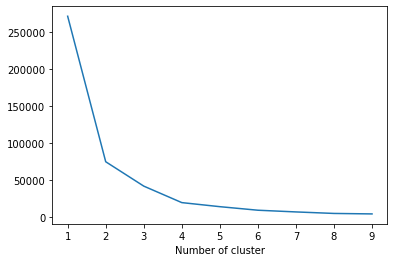

In [41]:
from sklearn.cluster import KMeans

sse={}
pi_recency = pd.DataFrame(pi_user.Recency_Transformed)
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(pi_recency)
    pi_recency["clusters"] = kmeans.labels_
    sse[k] = kmeans.inertia_ 
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()

Here it looks like 3 +/-1 is the optimal one . Based on business requirements, we can go ahead with less or more clusters. We will be selecting 4:

In [96]:
pi.columns

Index(['amount', 'credit_amount', 'id', 'user_id', 'city', 'paid_at', 'mobile',
       'Revenue'],
      dtype='object')

<p id="reck">
    
### Using k-Means for Clustering Recency 

In [42]:
from sklearn.cluster import KMeans

In [43]:
#build 4 clusters for recency and add it to dataframe
kmeans = KMeans(n_clusters = 4)
# pi_user_not_inf = pi_user[pi_user['Recency'] != np.inf].reset_index()
# kmeans.fit(pi_user_not_inf[["Recency"]])
kmeans.fit(pi_user[["Recency_Transformed"]])
pi_user.loc[:, ["RecencyCluster"]] = kmeans.predict(pi_user[["Recency_Transformed"]])


pi_user = order_cluster('RecencyCluster', 'Recency_Transformed',pi_user,False)
pi_user.groupby(["RecencyCluster"])["Recency"].describe()

,count,mean,std,min,25%,50%,75%,max
RecencyCluster,,,,,,,,
0,35711.0,220.718154,31.446590,162.0,195.0,222.0,248.0,274.0
1,50420.0,108.415510,23.943636,76.0,88.0,102.0,128.0,161.0
2,91409.0,46.451608,14.273024,27.0,34.0,44.0,58.0,75.0
3,93304.0,10.738725,8.013687,0.0,4.0,9.0,18.0,26.0


In [44]:
pi_user.head()

,user_id,Recency,Recency_Transformed,RecencyCluster
0,489707,274,2.627322,0
1,386097,274,2.627322,0
2,495466,250,2.367261,0
3,495442,244,2.301343,0
4,484016,274,2.627322,0


<div class="alert alert-success">
3 covers most recent customers whereas 0 has the most inactive ones.

<p id="recg">

### Gaussian Mixtures for Recency

https://scikit-learn.org/stable/modules/mixture.html<br>
https://jakevdp.github.io/PythonDataScienceHandbook/05.12-gaussian-mixtures.html

In [45]:
pi_user_g["RecencyCluster"] = 0

In [46]:
from sklearn.mixture import GaussianMixture

#build 4 clusters for recency and add it to dataframe
GMM = GaussianMixture(n_components=4, tol=0.002)
GMM.fit(pi_user_g[["Recency_Transformed"]])
pi_user_g[['RecencyCluster']] = GMM.predict(pi_user_g[["Recency_Transformed"]])

pi_user_g = order_cluster('RecencyCluster', 'Recency',pi_user_g,False)
pi_user_g.groupby(["RecencyCluster"])["Recency"].describe()

,count,mean,std,min,25%,50%,75%,max
RecencyCluster,,,,,,,,
0,35137.0,221.669437,30.801578,164.0,196.0,223.0,248.0,274.0
1,52160.0,108.263554,24.724230,75.0,88.0,102.0,128.0,163.0
2,95514.0,44.948594,14.384779,25.0,33.0,42.0,56.0,74.0
3,88033.0,9.853021,7.359556,0.0,3.0,9.0,16.0,24.0


<p id="freq" style="background:red; color:white"></p>

## Calculating *Frequency*

To create frequency clusters, we need to find total number orders for each customer. First calculate this and see how frequency look like in our customer database:

$$$$

In [47]:
pi_user.columns

Index(['user_id', 'Recency', 'Recency_Transformed', 'RecencyCluster'], dtype='object')

In [48]:
#get order counts for each user and create a dataframe with it
pi_frequency = pi.groupby('user_id').paid_at.count().reset_index()
pi_frequency.columns = ['user_id','Frequency']

#add this data to our main dataframe
pi_user = pd.merge(pi_user, pi_frequency, on='user_id')


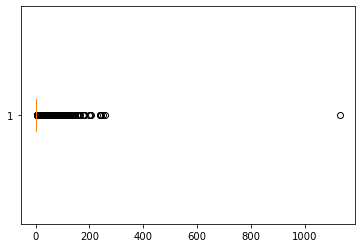

In [49]:
plt.boxplot(pi_user.Frequency, vert=False);

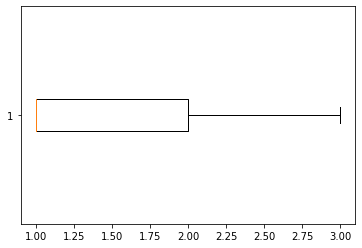

In [50]:
plt.boxplot(pi_user.query("Frequency < 4").Frequency, vert=False);

In [51]:
#plot the histogram
plot_data = [
    go.Histogram(
        x=pi_user.query("Frequency < 20").Frequency,
        marker=dict(
            color='rgba(110, 190, 0, .7)',
        ),
    )
]

plot_layout = go.Layout(
        title='Frequency',
        plot_bgcolor = "rgba(30, 50, 40, .3)",
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

<div class="alert alert-danger">
    
This is not good at all! The distribution is heavily skewed to the right, the users with more than 3 purchases are very scarce! So we'll either need to understand and check the state-of-the-art solutions in *Multivariate Statistics* area.

In [52]:
sc =StandardScaler()

#### Log- and Scaled-

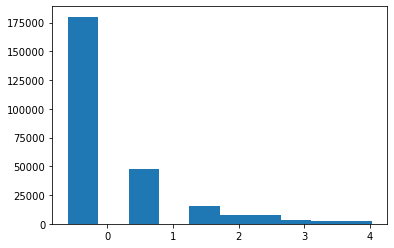

In [53]:
plt.hist(sc.fit_transform( np.log(pi_user.query("Frequency < 15").Frequency.values.reshape(-1,1)) ));

#### root, inverse and Scaled

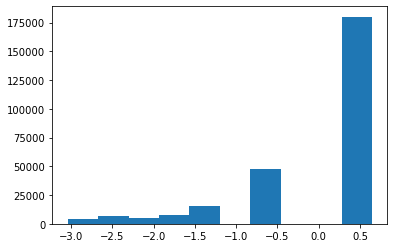

In [54]:
plt.hist(sc.fit_transform(1/(pi_user.query("Frequency < 15").Frequency.values.reshape(-1,1) ** (1/2))));

#### A Combined Form ?!%#!@?

In [55]:
xpu = pi_user.query("Frequency <= 10").Frequency.values.reshape(-1,1)
xpu = np.log(xpu) # an injective function
xpu = 1/np.exp(xpu) # an injective function
xpu = np.log(xpu) # an injective function
xpu = np.sign(xpu) * np.abs(xpu) ** (1/3) # an injective function
xpu = sc.fit_transform(xpu) # also an injection

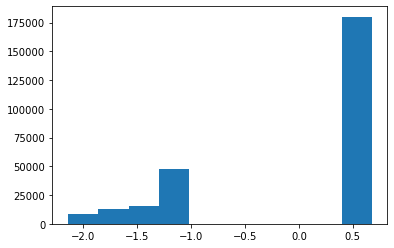

In [56]:
plt.hist(xpu);

In [57]:
pi_user.loc[pi_user.Frequency > 10, :].shape[0]

5525

In [58]:
pi_user.shape[0]

270844

In [59]:
sc = StandardScaler()
pi_user = pi_user.query("Frequency <= 10")
# pi_user[["Frequency_Transformed"]] = xpu

In [60]:
# Creating the dataset for the Gaussian and Quantiles Methods as well
# Since we're going to need scaled data as well, we're gonna copy that as well
# Must be executed once
pi_user_g = pd.merge(pi_user_g, pi_frequency, on="user_id")
pi_user_q = pd.merge(pi_user_q, pi_frequency, on="user_id")

In [61]:
pi_user_g = pi_user_g.query("Frequency <= 10")
# pi_user_g[["Frequency_Transformed"]] = xpu
pi_user_q = pi_user_q.query("Frequency <= 10")
# pi_user_q[["Frequency_Transformed"]] = xpu

<p id="freqq" style="background:red; color:white"></p>

### The Method of Quantiles for Frequency

In [62]:
pi_user_q.query("Frequency < 4").Frequency.describe()

count    243563.000000
mean          1.325333
std           0.591237
min           1.000000
25%           1.000000
50%           1.000000
75%           2.000000
max           3.000000
Name: Frequency, dtype: float64

In [64]:
# pi_user_q.Frequency_Transformed.isnull().sum()

In [65]:
# pi_user_q.Frequency_Transformed.describe()

In [66]:
pi_user_q.Frequency.describe()

count    265319.000000
mean          1.675726
std           1.394996
min           1.000000
25%           1.000000
50%           1.000000
75%           2.000000
max          10.000000
Name: Frequency, dtype: float64

In [67]:
pi_user_q["FrequencyCluster"] = 0
pi_user_q.loc[pi_user_q.Frequency >= 2, ["FrequencyCluster"]] = 1
# pi_user_q.loc[pi_user_q.Frequency_Transformed > -.6104, ["FrequencyCluster"]] = 2
pi_user_q.loc[pi_user_q.Frequency > 4, ["FrequencyCluster"]] = 3

In [68]:
pi_user_q.dropna().isnull().sum()

user_id                0
Recency                0
Recency_Transformed    0
RecencyCluster         0
Frequency              0
FrequencyCluster       0
dtype: int64

In [69]:
pi_user_q.FrequencyCluster.value_counts()

0    180164
1     71465
3     13690
Name: FrequencyCluster, dtype: int64

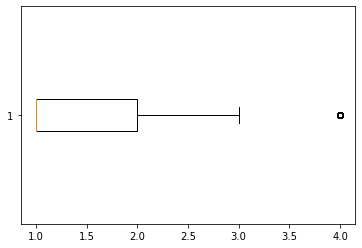

In [70]:
plt.boxplot(pi_user.query("Frequency < 5").Frequency, vert=False);

<p id="freqk" style="background:red; color:white"></p>

### k-Means for Frequency

Apply the same logic for having frequency clusters and assign this to each customer:

In [71]:
sc = StandardScaler()

pi_user[["Frequency_Transformed"]] = np.sign(pi_user.Frequency.values.reshape(-1,1)) * np.abs(sc.fit_transform(pi_user.Frequency.values.reshape(-1,1))) ** (1/3)

In [72]:
pi_user.isnull().sum()

user_id                  0
Recency                  0
Recency_Transformed      0
RecencyCluster           0
Frequency                0
Frequency_Transformed    0
dtype: int64

In [73]:
#k-means
kmeans = KMeans(n_clusters=4)
kmeans.fit(pi_user[["Frequency_Transformed"]])
pi_user[["FrequencyCluster"]] = kmeans.predict(pi_user[["Frequency_Transformed"]])

#order the frequency cluster
pi_user = order_cluster('FrequencyCluster', 'Frequency', pi_user, True)

#see details of each cluster
pi_user.groupby('FrequencyCluster')['Frequency'].describe()

,count,mean,std,min,25%,50%,75%,max
FrequencyCluster,,,,,,,,
0,180164.0,1.000000,0.000000,1.0,1.0,1.0,1.0,1.0
1,47559.0,2.000000,0.000000,2.0,2.0,2.0,2.0,2.0
2,23906.0,3.337405,0.472834,3.0,3.0,3.0,4.0,4.0
3,13690.0,6.540248,1.569961,5.0,5.0,6.0,8.0,10.0


In [74]:
pi_user.loc[pi_user.Frequency == 3].shape[0]

15840

In [75]:
#verifying number of clusters
pi_user.FrequencyCluster.nunique()

4

In [76]:
pi_user_g[["Frequency_Transformed"]] = sc.fit_transform(pi_user_g.Frequency.values.reshape(-1,1))

pi_user_g[["Frequency_Transformed"]] = np.sign(pi_user_g.Frequency_Transformed
                                              ) * np.abs(pi_user_g.Frequency_Transformed.values)**(1/3)

In [77]:
pi_user_g.head()

,user_id,Recency,Recency_Transformed,RecencyCluster,Frequency,Frequency_Transformed
0,489707,274,2.627322,0,1,-0.785355
1,386097,274,2.627322,0,1,-0.785355
2,495466,250,2.367261,0,10,1.813808
3,495442,244,2.301343,0,3,0.982808
4,484016,274,2.627322,0,1,-0.785355


In [78]:
pi_user_g.isnull().sum()

user_id                  0
Recency                  0
Recency_Transformed      0
RecencyCluster           0
Frequency                0
Frequency_Transformed    0
dtype: int64

<p id="freqg" style="background:red; color:white"></p>

### Gaussian Mixtures for Frequency

In [79]:
pi_user_g.query("Frequency == 2297")

,user_id,Recency,Recency_Transformed,RecencyCluster,Frequency,Frequency_Transformed


In [80]:
#gaussian mixture
gmm = GaussianMixture(n_components=4)
gmm.fit(pi_user_g[["Frequency_Transformed"]])
pi_user_g[['FrequencyCluster']] = gmm.predict(pi_user_g[["Frequency_Transformed"]])

#order the frequency cluster
pi_user_g = order_cluster('FrequencyCluster', 'Frequency', pi_user_g, True)

#see details of each cluster
pi_user_g.groupby('FrequencyCluster')['Frequency'].describe()

,count,mean,std,min,25%,50%,75%,max
FrequencyCluster,,,,,,,,
0,180164.0,1.000000,0.000000,1.0,1.0,1.0,1.0,1.0
1,47559.0,2.000000,0.000000,2.0,2.0,2.0,2.0,2.0
2,28722.0,3.616183,0.756224,3.0,3.0,3.0,4.0,5.0
3,8874.0,7.376155,1.347633,6.0,6.0,7.0,8.0,10.0


<p id="mon"></p>

## Calculating *Monetary* (aka Revenue)

<div class="alert alert-danger">
Revenue is calculated in Toman.

In [81]:
pi_user.head()

,user_id,Recency,Recency_Transformed,RecencyCluster,Frequency,Frequency_Transformed,FrequencyCluster
0,489707,274,2.627322,0,1,0.785355,0
1,386097,274,2.627322,0,1,0.785355,0
2,484016,274,2.627322,0,1,0.785355,0
3,495482,274,2.627322,0,1,0.785355,0
4,477236,274,2.627322,0,1,0.785355,0


In [82]:
#calculate revenue for each customer
pi_revenue = (pi.groupby('user_id').Revenue.sum()).reset_index()

#merge it with our main dataframe
pi_user = pd.merge(pi_user, pi_revenue, on='user_id')

In [83]:
pi_user[["Revenue", "Recency", "Frequency"]].corr()

,Revenue,Recency,Frequency
Revenue,1.000000,-0.093904,0.475381
Recency,-0.093904,1.000000,-0.174698
Frequency,0.475381,-0.174698,1.000000


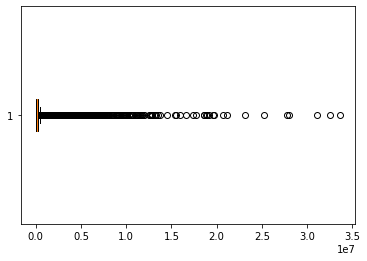

In [84]:
plt.boxplot(pi_user.Revenue, vert=False);

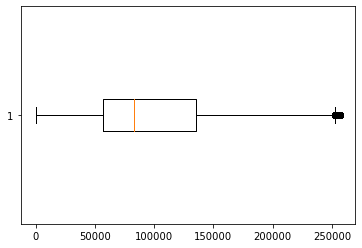

In [85]:
plt.boxplot(pi_user.query("Revenue < .257e6").Revenue, vert=False);

In [86]:
pi_user.query("Revenue > 247000").shape[0] / pi_user.shape[0]

0.20715063753443969

Only 20.7% of our customers generated revenue more than 247k toman. Whereas 60% of these are below 500k toman.

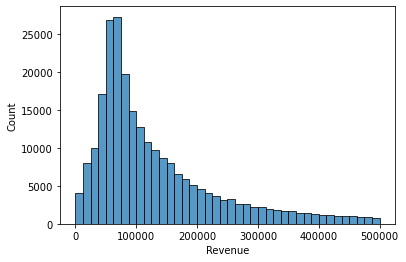

In [87]:
sns.histplot(pi_user.query("Revenue < 500000")["Revenue"], bins=40);

In [88]:
rev_tr = pi_user.query("Revenue < 500000").values.reshape(-1,1)
# rev_tr = np.log(rev_tr + 501)
# rev_tr = sc.fit_transform(rev_tr)
# rev_tr = np.sign(rev_tr) * np.abs(rev_tr) ** (1/3)
rev_tr = sc.fit_transform(rev_tr)

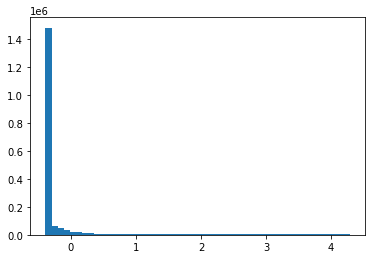

In [89]:
plt.hist(rev_tr, bins=50);

In [90]:
#plot the histogram
plot_data = [
    go.Histogram(
        x=pi_user.query("Revenue < 500000")['Revenue'],
        marker=dict(
            color='rgba(190, 10, 40, .7)',
        ),
        nbinsx=80
    )
]

plot_layout = go.Layout(
        title='Monetary Value',
        autosize=False,
        width=900,
        height=400,
        plot_bgcolor = "rgba(30, 50, 40, .2)",
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [91]:
pi_user = pi_user.query("Revenue < 500000")

In [92]:
pi_user.isnull().sum()

user_id                  0
Recency                  0
Recency_Transformed      0
RecencyCluster           0
Frequency                0
Frequency_Transformed    0
FrequencyCluster         0
Revenue                  0
dtype: int64

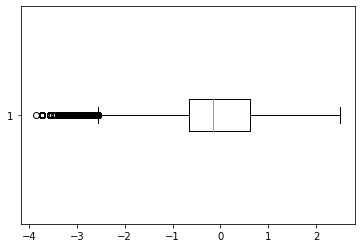

In [93]:
Revenue_array = np.sign(pi_user.Revenue) * np.abs((pi_user.Revenue).values) ** (1/3)
Revenue_array = (Revenue_array - Revenue_array.mean())/Revenue_array.std()

plt.boxplot(Revenue_array, vert=False);

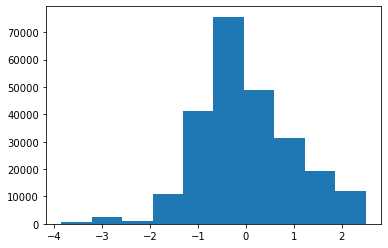

In [94]:
plt.hist(Revenue_array);

In [95]:
pi_user[["Revenue_Transformed"]] = Revenue_array

In [98]:
pi_user.shape[0], pi_user_q.shape[0]

(243080, 243080)

In [97]:
pi_user_g = pd.merge(pi_user_g, pi_revenue, on="user_id").query("Revenue < 500000")
pi_user_q = pd.merge(pi_user_q, pi_revenue, on="user_id").query("Revenue < 500000")

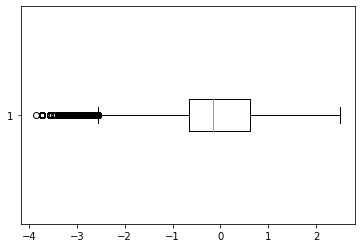

In [99]:
# And now for the Quantiles
Revenue_array = np.sign(pi_user_q.Revenue) * np.abs((pi_user_q.Revenue).values) ** (1/3)
Revenue_array = (Revenue_array - Revenue_array.mean())/Revenue_array.std()

pi_user_q[["Revenue_Transformed"]] = Revenue_array

plt.boxplot(Revenue_array, vert=False);

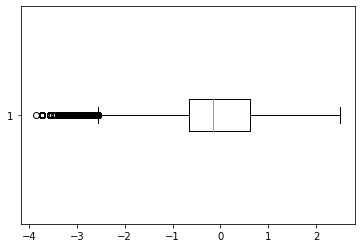

In [100]:
# And now for the Quantiles
Revenue_array = np.sign(pi_user_g.Revenue) * np.abs((pi_user_g.Revenue).values) ** (1/3)
Revenue_array = (Revenue_array - Revenue_array.mean())/Revenue_array.std()

pi_user_g[["Revenue_Transformed"]] = Revenue_array

plt.boxplot(Revenue_array, vert=False);

In [101]:
pi.query("Revenue > 0.202100e+08").shape[0]

3

<p id="monq"></p>


### The Method of Quantiles for Monetary 

In [102]:
pi_user_q.Revenue_Transformed.describe()

count    2.430800e+05
mean    -9.915094e-17
std      1.000000e+00
min     -3.857032e+00
25%     -6.522858e-01
50%     -1.502898e-01
75%      6.221178e-01
max      2.502185e+00
Name: Revenue_Transformed, dtype: float64

In [103]:
pi_user_q[["RevenueCluster"]] = 0
pi_user_q.loc[pi_user_q.Revenue_Transformed >= -6.515054e-01, ["RevenueCluster"]] = 1
pi_user_q.loc[pi_user_q.Revenue_Transformed >= -1.498930e-01, ["RevenueCluster"]] = 2
pi_user_q.loc[pi_user_q.Revenue_Transformed >= 6.219241e-01, ["RevenueCluster"]] = 3

In [104]:
pi_user_q.isnull().sum()

user_id                0
Recency                0
Recency_Transformed    0
RecencyCluster         0
Frequency              0
FrequencyCluster       0
Revenue                0
Revenue_Transformed    0
RevenueCluster         0
dtype: int64

In [105]:
pi_user_q.RevenueCluster.value_counts()

0    61241
3    61132
1    60380
2    60327
Name: RevenueCluster, dtype: int64

<p id="monk"></p>


### Using k-Means for Clustering Revenue

In [106]:
#apply clustering
kmeans = KMeans(n_clusters=4)
kmeans.fit(pi_user[['Revenue_Transformed']])
pi_user[["RevenueCluster"]] = kmeans.predict(pi_user[['Revenue_Transformed']])

#order the cluster numbers
pi_user = order_cluster('RevenueCluster', 'Revenue_Transformed', pi_user, True)

#show details of the dataframe
pi_user.groupby('RevenueCluster')['Revenue'].describe()

,count,mean,std,min,25%,50%,75%,max
RevenueCluster,,,,,,,,
0,21246.0,20851.896291,10843.501395,-5.0,15000.0,22500.0,30000.0,36270.0
1,108718.0,67632.357604,16848.768259,36300.0,54500.0,66600.0,80100.0,101610.0
2,73533.0,150248.181369,33614.865916,101620.0,120740.0,145000.0,176000.0,222580.0
3,39583.0,324892.948938,76494.557075,222590.0,258994.0,308460.0,381040.0,499930.0


In [107]:
pi_user.isnull().sum()

user_id                  0
Recency                  0
Recency_Transformed      0
RecencyCluster           0
Frequency                0
Frequency_Transformed    0
FrequencyCluster         0
Revenue                  0
Revenue_Transformed      0
RevenueCluster           0
dtype: int64

<p id="mong"></p>


### Gaussian Mixture for Monetary

In [108]:
pi_user_g["RevenueCluster"] = 3

In [109]:
pi_user_g.head()

,user_id,Recency,Recency_Transformed,RecencyCluster,Frequency,Frequency_Transformed,FrequencyCluster,Revenue,Revenue_Transformed,RevenueCluster
0,489707,274,2.627322,0,1,-0.785355,0,77500.0,-0.378829,3
1,386097,274,2.627322,0,1,-0.785355,0,117000.0,0.113322,3
2,484016,274,2.627322,0,1,-0.785355,0,295000.0,1.498449,3
3,495482,274,2.627322,0,1,-0.785355,0,144900.0,0.396791,3
4,477236,274,2.627322,0,1,-0.785355,0,45000.0,-0.933063,3


In [110]:
pi_user_g.isnull().sum()

user_id                  0
Recency                  0
Recency_Transformed      0
RecencyCluster           0
Frequency                0
Frequency_Transformed    0
FrequencyCluster         0
Revenue                  0
Revenue_Transformed      0
RevenueCluster           0
dtype: int64

In [111]:
#gaussian mixture
gmm = GaussianMixture(n_components=4, tol=0.0512)
gmm.fit(pi_user[["Revenue_Transformed"]])
pi_user_g[["RevenueCluster"]] = gmm.predict(pi_user_g[["Revenue_Transformed"]])

#order the frequency cluster
pi_user_g = order_cluster('RevenueCluster', 'Revenue_Transformed', pi_user_g, True)

#see details of each cluster
pi_user_g.groupby('RevenueCluster')['Revenue'].describe()

,count,mean,std,min,25%,50%,75%,max
RevenueCluster,,,,,,,,
0,16403.0,17114.375035,9496.228686,-5.0,12500.0,18800.0,25000.0,30320.0
1,113648.0,66204.375026,17892.782088,30350.0,52470.0,65270.0,80000.0,101750.0
2,72916.0,149787.782694,33159.196306,101800.0,120600.0,144800.0,175000.0,220610.0
3,40113.0,323527.616770,76898.195290,220640.0,257000.0,306550.0,380000.0,499930.0


In [112]:
pi_user_g['RevenueCluster'].nunique()

4

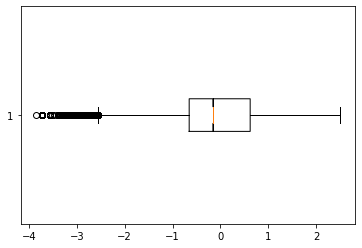

In [113]:
plt.boxplot(pi_user_g.Revenue_Transformed, vert=False, notch=True);

<p id="overal"></p>


## Overall Score

<div class="alert alert-info">
$$\text{Recency Score}^2 + \text{Frequency Score}^2 + \text{Monetary Score}^2 = \text{Overall Score}$$

In [114]:
pi_user.head()

,user_id,Recency,Recency_Transformed,RecencyCluster,Frequency,Frequency_Transformed,FrequencyCluster,Revenue,Revenue_Transformed,RevenueCluster
0,489707,274,2.627322,0,1,0.785355,0,77500.0,-0.378829,1
1,477236,274,2.627322,0,1,0.785355,0,45000.0,-0.933063,1
2,495494,274,2.627322,0,1,0.785355,0,55700.0,-0.727465,1
3,495525,274,2.627322,0,1,0.785355,0,74000.0,-0.429947,1
4,494405,274,2.627322,0,1,0.785355,0,41700.0,-1.002998,1


### OverallScore for Gaussian and KMeans

In [115]:
# Gaussian
pi_user_g['OverallScore'] = pi_user_g['RecencyCluster']**2 + pi_user_g['FrequencyCluster']**2 + pi_user_g['RevenueCluster']**2
pi_user_g.groupby('OverallScore').user_id.count()

OverallScore
0      4885
1     21208
2     22917
3      2344
4      9506
5     50762
6      5382
8     17832
9     12897
10    31836
11     4280
12     1379
13    17271
14    16166
17     7531
18     3555
19     4886
22     7124
27     1319
Name: user_id, dtype: int64

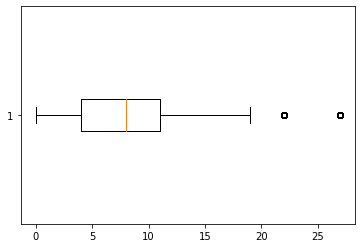

In [116]:
plt.boxplot(pi_user_g.OverallScore,vert=False);

In [117]:
#calculate overall score and use mean() to see details
pi_user['OverallScore'] = pi_user['RecencyCluster']**2 + pi_user['FrequencyCluster']**2 + pi_user['RevenueCluster']**2
pi_user.groupby('OverallScore').user_id.count()

OverallScore
0      6139
1     21852
2     20534
3      2152
4     10686
5     47924
6      5190
8     17191
9     13204
10    33302
11     4191
12     1252
13    17959
14    16213
17     6814
18     3861
19     5285
22     6717
27     2614
Name: user_id, dtype: int64

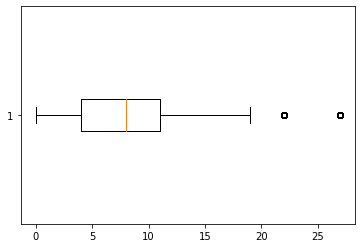

In [118]:
plt.boxplot(pi_user.OverallScore, vert=False);

In [119]:
pi_user_q.head()

,user_id,Recency,Recency_Transformed,RecencyCluster,Frequency,FrequencyCluster,Revenue,Revenue_Transformed,RevenueCluster
0,489707,274,2.627322,0,1,0,77500.0,-0.378829,1
2,386097,274,2.627322,0,1,0,117000.0,0.113322,2
4,495442,244,2.301343,0,3,1,273520.0,1.368514,3
5,495437,151,1.221473,0,2,1,151200.0,0.455652,2
7,484016,274,2.627322,0,1,0,295000.0,1.498449,3


In [120]:
pi_user_q['OverallScore'] = pi_user_q['RecencyCluster']**2 + pi_user_q['FrequencyCluster']**2 + pi_user_q['RevenueCluster']**2
pi_user_q.groupby('OverallScore').user_id.count()

OverallScore
0     24783
1     26994
2     17782
3      1284
4     20983
5     30787
6      5702
8     11242
9     20071
10    24176
11     8388
13    14109
14    16865
17       29
18     4673
19    11635
22     1041
27     2536
Name: user_id, dtype: int64

<div class="alert alert-success">
The scoring above clearly shows us that customers with score 8 is our best customers whereas 0 is the worst.

To keep things simple, better we name these scores:

 - 0 to 7: Low Value
 - 8 to 13: Mid Value
 - 14+: High Value

We can easily apply this naming on our dataframe:

In [121]:
pi_user['Segment'] = 'Low-Value'
pi_user.loc[pi_user['OverallScore'] > 7,'Segment'] = 'Mid-Value' 
pi_user.loc[pi_user['OverallScore'] > 13,'Segment'] = 'High-Value' 

In [122]:
pi_user.Segment.value_counts()

Low-Value     114477
Mid-Value      87099
High-Value     41504
Name: Segment, dtype: int64

In [123]:
pi_user_g['Segment'] = 'Low-Value'
pi_user_g.loc[pi_user_g['OverallScore'] > 7,'Segment'] = 'Mid-Value' 
pi_user_g.loc[pi_user_g['OverallScore'] > 13,'Segment'] = 'High-Value' 

In [124]:
pi_user_g.Segment.value_counts()

Low-Value     117004
Mid-Value      85495
High-Value     40581
Name: Segment, dtype: int64

<div class="alert alert-info">
Advised by Mr. Sadeghi, there's still yet a better evaluation to justify our segments by means of `re`(RegEx package):
    
First we transform them into strings, concatenating them and ultimately process as follows:
    
- Having only 1's and 0's will be residing in `Low-Value`.
- Having one 3 and two 2's, two 3's and one 2 and three 3's will reside the customer in the `High-Value` segment.
- Having no zero's and two 2's means `Upper-Mid-Value`.
- The rest goes in `Lower-Mid-Value`.
    
We will apply this on `pi_user_q`:

In [125]:
df = pi_user_q.copy()

In [126]:
df.RevenueCluster.nunique()

4

In [127]:
import re
np.random.seed()
shuffled_numbers = [np.random.randint(0, df.shape[0]) for i in range(10)]

df["OverallScore"] = df.RecencyCluster.astype(str) + df.FrequencyCluster.astype(str) + df.RevenueCluster.astype(str)
for i in shuffled_numbers:
    print(df.loc[i,"OverallScore"])

202
000
202
000
010
001
000
301
113
000


In [128]:
df[:3]

,user_id,Recency,Recency_Transformed,RecencyCluster,Frequency,FrequencyCluster,Revenue,Revenue_Transformed,RevenueCluster,OverallScore
0,489707,274,2.627322,0,1,0,77500.0,-0.378829,1,001
2,386097,274,2.627322,0,1,0,117000.0,0.113322,2,002
4,495442,244,2.301343,0,3,1,273520.0,1.368514,3,013


In [132]:
type(df.loc[4, "OverallScore"])

str

In [133]:
df.columns.shape

(10,)

In [134]:
import re

pattern_high = r"(?!222)[2-3][2-3][2-3]"
pattern_upper_mid = r"^(?=[1-3]{3}$)(?!.*(.).*\1).*$|303|330|033"
pattern_lower_mid = r"(?!222)[1-2][1-2][1-2]|030|300|003|202|220|022"

RFMScores = []
for i in range(df.shape[0]):
    if re.search(pattern_high, df.iloc[i, 9]):
        RFMScores.append(3)
    elif re.search(pattern_upper_mid, df.iloc[i, 9]):
        RFMScores.append(2)
    elif re.search(pattern_lower_mid, df.iloc[i, 9]):
        RFMScores.append(1)
    else:
        RFMScores.append(0)
        
df["RFMScore"] = pd.Series(RFMScores)

In [135]:
df["Segment"] = "Low-Value"

In [136]:
df.loc[df.RFMScore == 1, ["Segment"]] = "Mid-Value"
df.loc[df.RFMScore > 1, ["Segment"]] = "High-Value"

In [137]:
pi_user_q = df

In [138]:
pi_user_q.Segment.nunique()

3

## Creating a sample

In [139]:
sample = pi_user.user_id.sample(frac=0.1, replace=False, random_state=42)

In [140]:
# pi_user_g.loc[mask_g,:].head()

NameError: name 'mask_g' is not defined

### k-Means Visualization

In [141]:
mask = pi_user.user_id.isin(sample)

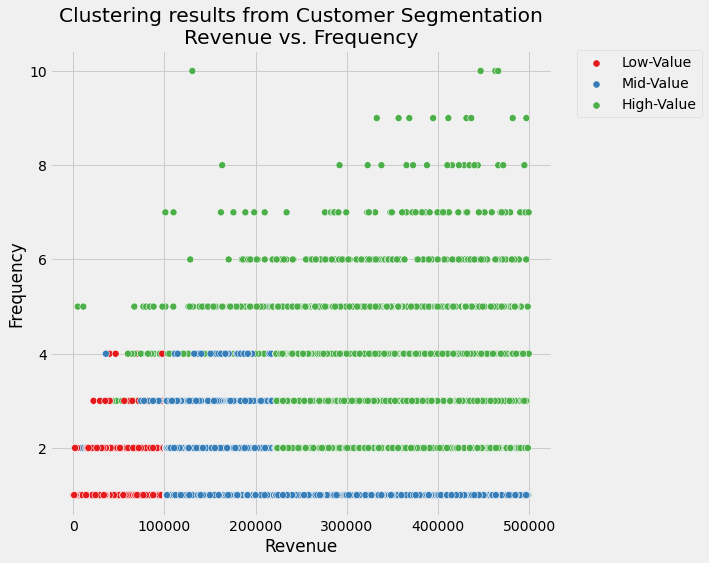

In [142]:
#Revenue vs Frequency

plt.style.use("fivethirtyeight")
plt.figure(figsize=(8, 8))

scat = sns.scatterplot("Revenue",
                       "Frequency",
                       s=50,
                       data=pi_user.loc[mask,:],
                       hue="Segment",
                       hue_order=["Low-Value", "Mid-Value", "High-Value"],
                       palette="Set1",)

scat.set_title("Clustering results from Customer Segmentation\nRevenue vs. Frequency")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)

plt.show()

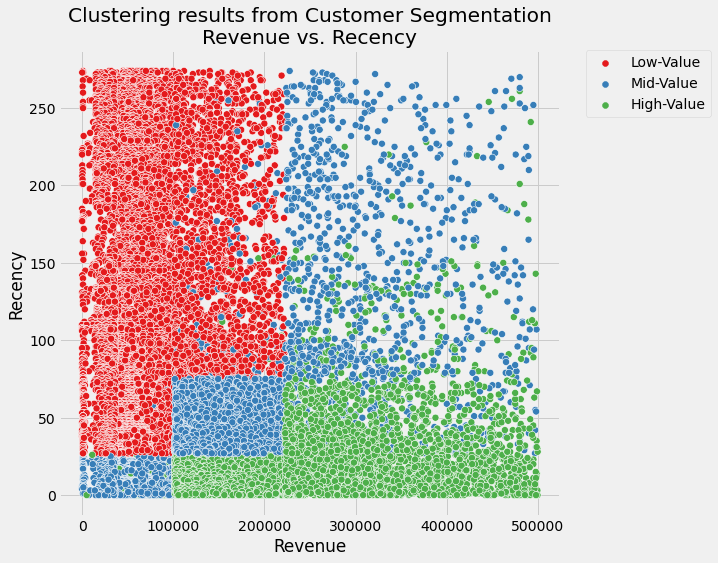

In [143]:
# Revenue vs. Recency

plt.style.use("fivethirtyeight")
plt.figure(figsize=(8, 8))

scat = sns.scatterplot("Revenue",
                       "Recency",
                       s=50,
                       data=pi_user.loc[mask,:],
                       hue="Segment",
                       hue_order=["Low-Value", "Mid-Value", "High-Value"],
                       palette="Set1")

scat.set_title("Clustering results from Customer Segmentation\nRevenue vs. Recency")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)

plt.show()

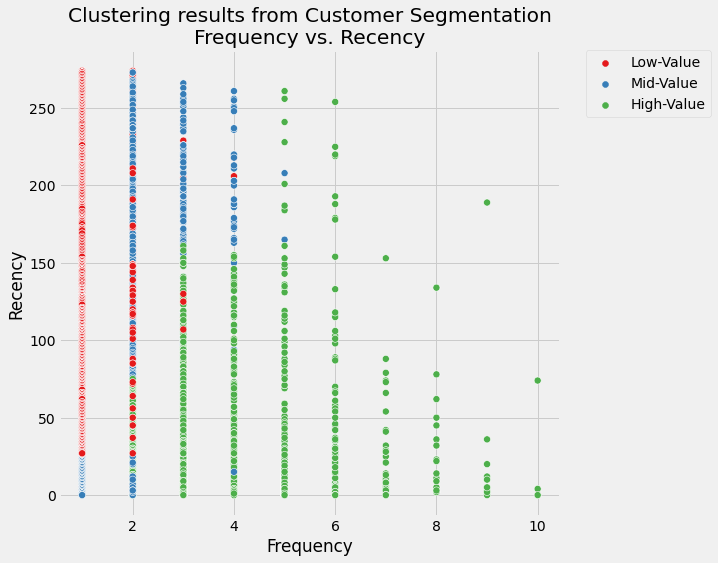

In [144]:
# Frequency vs. Recency

plt.style.use("fivethirtyeight")
plt.figure(figsize=(8, 8))

scat = sns.scatterplot("Frequency",
                       "Recency",
                       s=50,
                       data=pi_user.loc[mask,:],
                       hue="Segment",
                       hue_order=["Low-Value", "Mid-Value", "High-Value"],
                       palette="Set1")

scat.set_title("Clustering results from Customer Segmentation\nFrequency vs. Recency")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)

plt.show()

### Gaussian Visualization

In [145]:
mask_g = pi_user_g.user_id.isin(sample)

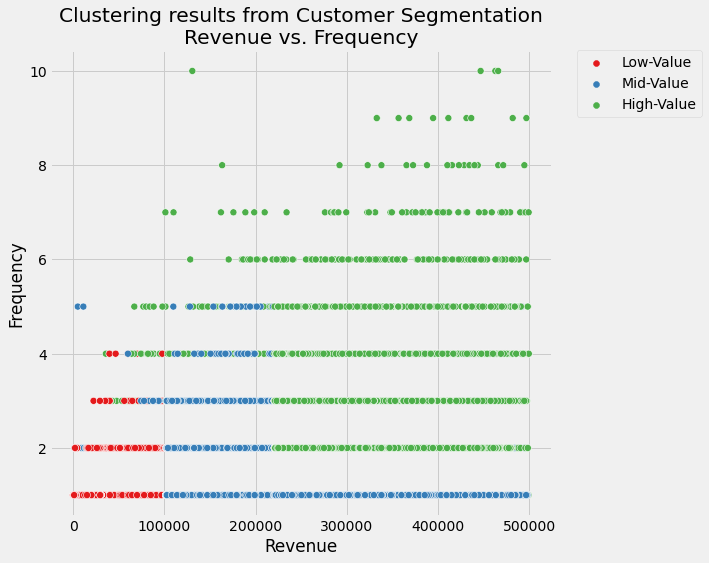

In [146]:
#Revenue vs Frequency

plt.style.use("fivethirtyeight")
plt.figure(figsize=(8, 8))

scat = sns.scatterplot("Revenue",
                       "Frequency",
                       s=50,
                       data=pi_user_g.loc[mask_g,:],
                       hue="Segment",
                       hue_order=["Low-Value", "Mid-Value", "High-Value"],
                       palette="Set1",)

scat.set_title("Clustering results from Customer Segmentation\nRevenue vs. Frequency")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)

plt.show()

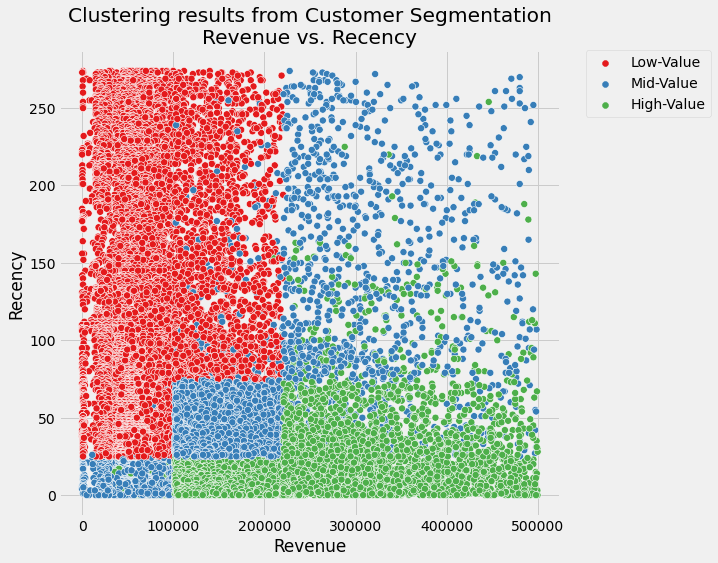

In [147]:
# Revenue vs. Recency

plt.style.use("fivethirtyeight")
plt.figure(figsize=(8, 8))

scat = sns.scatterplot("Revenue",
                       "Recency",
                       s=50,
                       data=pi_user_g.loc[mask_g,:],
                       hue="Segment",
                       hue_order=["Low-Value", "Mid-Value", "High-Value"],
                       palette="Set1")

scat.set_title("Clustering results from Customer Segmentation\nRevenue vs. Recency")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)

plt.show()

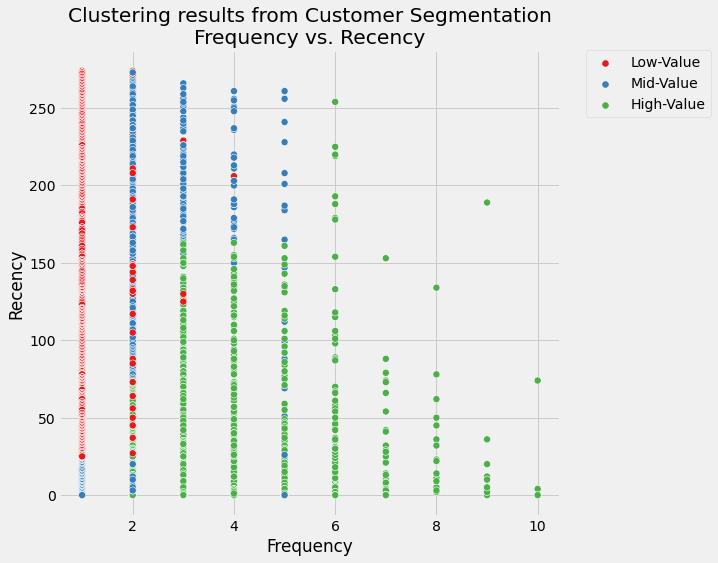

In [148]:
# Frequency vs. Recency

plt.style.use("fivethirtyeight")
plt.figure(figsize=(8, 8))

scat = sns.scatterplot("Frequency",
                       "Recency",
                       s=50,
                       data=pi_user_g.loc[mask_g,:],
                       hue="Segment",
                       hue_order=["Low-Value", "Mid-Value", "High-Value"],
                       palette="Set1")

scat.set_title("Clustering results from Customer Segmentation\nFrequency vs. Recency")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)

plt.show()

## The Method of Quantiles

In [149]:
mask_q = pi_user_q.user_id.isin(sample)

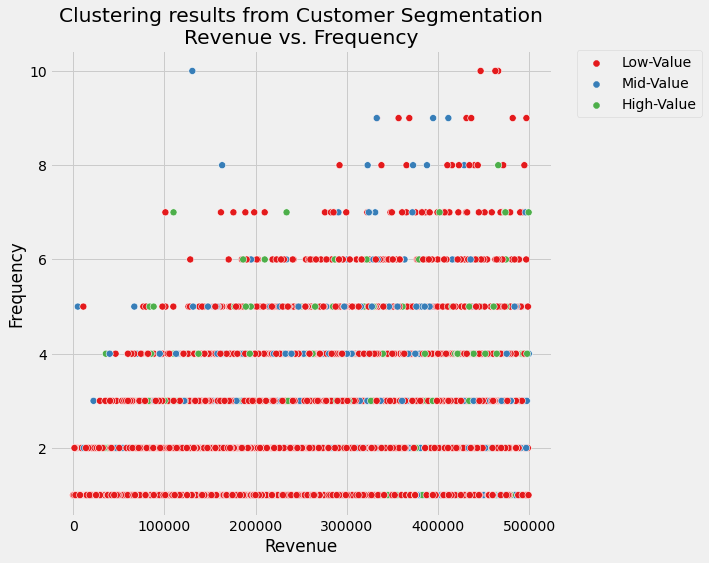

In [150]:
#Revenue vs Frequency

plt.style.use("fivethirtyeight")
plt.figure(figsize=(8, 8))

scat = sns.scatterplot("Revenue",
                       "Frequency",
                       s=50,
                       data=pi_user_q.loc[mask_q,:],
                       hue="Segment",
                       hue_order=["Low-Value", "Mid-Value", "High-Value"],
                       palette="Set1",)

scat.set_title("Clustering results from Customer Segmentation\nRevenue vs. Frequency")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)

plt.show()

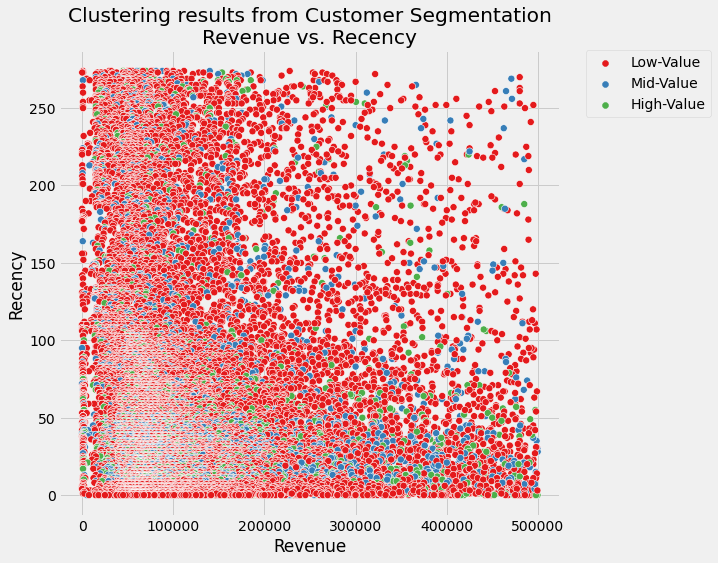

In [151]:
# Revenue vs. Recency

plt.style.use("fivethirtyeight")
plt.figure(figsize=(8, 8))

scat = sns.scatterplot("Revenue",
                       "Recency",
                       s=50,
                       data=pi_user_q.loc[mask_q,:],
                       hue="Segment",
                       hue_order=["Low-Value", "Mid-Value", "High-Value"],
                       palette="Set1")

scat.set_title("Clustering results from Customer Segmentation\nRevenue vs. Recency")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)

plt.show()

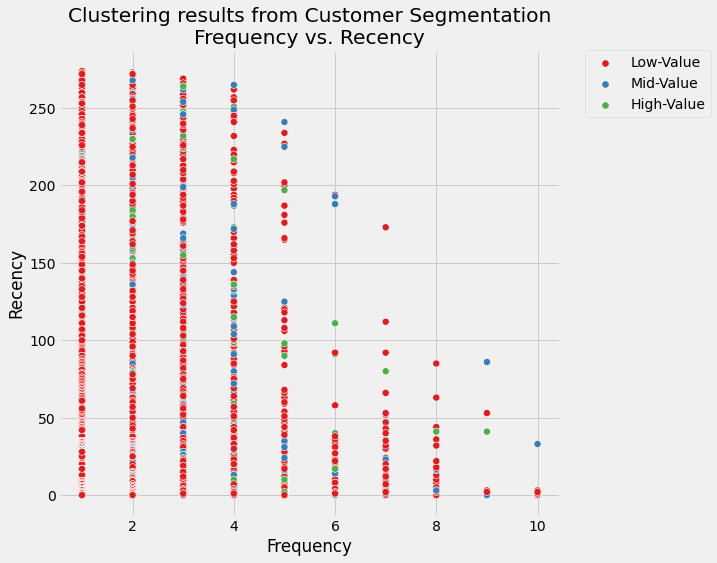

In [337]:
# Frequency vs. Recency

plt.style.use("fivethirtyeight")
plt.figure(figsize=(8, 8))

scat = sns.scatterplot("Frequency",
                       "Recency",
                       s=50,
                       data=pi_user_q.loc[mask_q,:],
                       hue="Segment",
                       hue_order=["Low-Value", "Mid-Value", "High-Value"],
                       palette="Set1")

scat.set_title("Clustering results from Customer Segmentation\nFrequency vs. Recency")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)

plt.show()

We can start taking actions with this segmentation. The main strategies are quite clear:

    High Value: Improve Retention
    Mid Value: Improve Retention + Increase Frequency
    Low Value: Increase Frequency

### Categories and Locations?

In [106]:
pi_user.to_csv("rfm-segmented.csv"), pi_user_g.to_csv("rfm-segmented-gaussian.csv"), pi_user_q.to_csv("rfm-segmented-quantiles.csv");